In [31]:
# umpire strike zone tendencies

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import pybaseball as pyb

In [120]:
df = pyb.statcast(start_dt='2021-03-21', end_dt='2021-10-15')

This is a large query, it may take a moment to complete


/Applications/anaconda3/lib/python3.8/site-packages/pybaseball/statcast.py:50: UserWarning:


That's a nice request you got there. It'd be a shame if something were to happen to it.
We strongly recommend that you enable caching before running this. It's as simple as `pybaseball.cache.enable()`.
Since the Statcast requests can take a *really* long time to run, if something were to happen, like: a disconnect;
gremlins; computer repair by associates of Rudy Giuliani; electromagnetic interference from metal trash cans; etc.;
you could lose a lot of progress. Enabling caching will allow you to immediately recover all the successful
subqueries if that happens.

100%|██████████| 209/209 [01:11<00:00,  2.94it/s]


In [121]:
df

,pitch_type,game_date,release_speed,release_pos_x,release_pos_z,player_name,batter,pitcher,events,description,...,fld_score,post_away_score,post_home_score,post_bat_score,post_fld_score,if_fielding_alignment,of_fielding_alignment,spin_axis,delta_home_win_exp,delta_run_exp
157,FF,2021-10-15,95.8,-0.12,5.94,"Pressly, Ryan",646240,519151,field_out,hit_into_play,...,5,4,5,4,5,Infield shift,Standard,193,0.035,-0.091
161,FF,2021-10-15,96.7,-0.17,5.96,"Pressly, Ryan",646240,519151,NaN,ball,...,5,4,5,4,5,Infield shift,Standard,197,0.0,0.018
173,FF,2021-10-15,97.3,-0.34,5.97,"Pressly, Ryan",646240,519151,NaN,ball,...,5,4,5,4,5,Infield shift,Standard,200,0.0,0.011
196,FF,2021-10-15,96.3,-0.4,5.89,"Pressly, Ryan",646240,519151,NaN,foul,...,5,4,5,4,5,Infield shift,Standard,202,0.0,-0.024
202,FF,2021-10-15,95.9,-0.28,5.98,"Pressly, Ryan",646240,519151,NaN,called_strike,...,5,4,5,4,5,Infield shift,Standard,201,0.0,-0.018
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3537,FF,2021-04-01,95.9,-1.92,6.15,"Márquez, Germán",605141,608566,NaN,called_strike,...,0,0,0,0,0,Standard,Standard,212,0.0,-0.077
3650,FF,2021-04-01,95.4,-1.69,6.17,"Márquez, Germán",605141,608566,NaN,ball,...,0,0,0,0,0,Strategic,Standard,<NA>,0.0,0.113
3844,FF,2021-04-01,96.1,-1.76,6.27,"Márquez, Germán",605141,608566,NaN,ball,...,0,0,0,0,0,Strategic,Standard,208,0.0,0.052
3968,FF,2021-04-01,95.6,-2.04,6.03,"Márquez, Germán",605141,608566,NaN,foul,...,0,0,0,0,0,Standard,Standard,195,0.0,-0.049


In [122]:
df.columns

Index(['pitch_type', 'game_date', 'release_speed', 'release_pos_x',
       'release_pos_z', 'player_name', 'batter', 'pitcher', 'events',
       'description', 'spin_dir', 'spin_rate_deprecated',
       'break_angle_deprecated', 'break_length_deprecated', 'zone', 'des',
       'game_type', 'stand', 'p_throws', 'home_team', 'away_team', 'type',
       'hit_location', 'bb_type', 'balls', 'strikes', 'game_year', 'pfx_x',
       'pfx_z', 'plate_x', 'plate_z', 'on_3b', 'on_2b', 'on_1b',
       'outs_when_up', 'inning', 'inning_topbot', 'hc_x', 'hc_y',
       'tfs_deprecated', 'tfs_zulu_deprecated', 'fielder_2', 'umpire', 'sv_id',
       'vx0', 'vy0', 'vz0', 'ax', 'ay', 'az', 'sz_top', 'sz_bot',
       'hit_distance_sc', 'launch_speed', 'launch_angle', 'effective_speed',
       'release_spin_rate', 'release_extension', 'game_pk', 'pitcher.1',
       'fielder_2.1', 'fielder_3', 'fielder_4', 'fielder_5', 'fielder_6',
       'fielder_7', 'fielder_8', 'fielder_9', 'release_pos_y',
       'estima

In [123]:
df['umpire'].value_counts()

Series([], Name: umpire, dtype: Int64)

In [160]:
df['game_type'].value_counts()

R    709851
D      4969
F       574
L       315
Name: game_type, dtype: int64

In [124]:
df[['game_date', 'home_team']].value_counts()

game_date   home_team
2021-07-21  ATL          566
2021-09-04  WSH          559
2021-09-11  BAL          551
2021-08-25  CHC          550
2021-06-30  CLE          531
                        ... 
2021-06-29  COL          205
2021-06-30  CIN          190
2021-05-28  BOS          185
2021-07-01  WSH          177
2021-08-31  NYM          175
Length: 2391, dtype: int64

In [125]:
# Just look at one game
# pit = df[df['home_team']=='ARI']

# Look at all games
pit = df
pit



,pitch_type,game_date,release_speed,release_pos_x,release_pos_z,player_name,batter,pitcher,events,description,...,fld_score,post_away_score,post_home_score,post_bat_score,post_fld_score,if_fielding_alignment,of_fielding_alignment,spin_axis,delta_home_win_exp,delta_run_exp
157,FF,2021-10-15,95.8,-0.12,5.94,"Pressly, Ryan",646240,519151,field_out,hit_into_play,...,5,4,5,4,5,Infield shift,Standard,193,0.035,-0.091
161,FF,2021-10-15,96.7,-0.17,5.96,"Pressly, Ryan",646240,519151,NaN,ball,...,5,4,5,4,5,Infield shift,Standard,197,0.0,0.018
173,FF,2021-10-15,97.3,-0.34,5.97,"Pressly, Ryan",646240,519151,NaN,ball,...,5,4,5,4,5,Infield shift,Standard,200,0.0,0.011
196,FF,2021-10-15,96.3,-0.4,5.89,"Pressly, Ryan",646240,519151,NaN,foul,...,5,4,5,4,5,Infield shift,Standard,202,0.0,-0.024
202,FF,2021-10-15,95.9,-0.28,5.98,"Pressly, Ryan",646240,519151,NaN,called_strike,...,5,4,5,4,5,Infield shift,Standard,201,0.0,-0.018
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3537,FF,2021-04-01,95.9,-1.92,6.15,"Márquez, Germán",605141,608566,NaN,called_strike,...,0,0,0,0,0,Standard,Standard,212,0.0,-0.077
3650,FF,2021-04-01,95.4,-1.69,6.17,"Márquez, Germán",605141,608566,NaN,ball,...,0,0,0,0,0,Strategic,Standard,<NA>,0.0,0.113
3844,FF,2021-04-01,96.1,-1.76,6.27,"Márquez, Germán",605141,608566,NaN,ball,...,0,0,0,0,0,Strategic,Standard,208,0.0,0.052
3968,FF,2021-04-01,95.6,-2.04,6.03,"Márquez, Germán",605141,608566,NaN,foul,...,0,0,0,0,0,Standard,Standard,195,0.0,-0.049


In [126]:
pit['description'].value_counts()

ball                       238783
foul                       127091
hit_into_play              122711
called_strike              117547
swinging_strike             76419
blocked_ball                17457
foul_tip                     6795
swinging_strike_blocked      4767
hit_by_pitch                 2127
foul_bunt                    1575
missed_bunt                   362
bunt_foul_tip                  41
pitchout                       33
foul_pitchout                   1
Name: description, dtype: int64

In [127]:
pit.columns

Index(['pitch_type', 'game_date', 'release_speed', 'release_pos_x',
       'release_pos_z', 'player_name', 'batter', 'pitcher', 'events',
       'description', 'spin_dir', 'spin_rate_deprecated',
       'break_angle_deprecated', 'break_length_deprecated', 'zone', 'des',
       'game_type', 'stand', 'p_throws', 'home_team', 'away_team', 'type',
       'hit_location', 'bb_type', 'balls', 'strikes', 'game_year', 'pfx_x',
       'pfx_z', 'plate_x', 'plate_z', 'on_3b', 'on_2b', 'on_1b',
       'outs_when_up', 'inning', 'inning_topbot', 'hc_x', 'hc_y',
       'tfs_deprecated', 'tfs_zulu_deprecated', 'fielder_2', 'umpire', 'sv_id',
       'vx0', 'vy0', 'vz0', 'ax', 'ay', 'az', 'sz_top', 'sz_bot',
       'hit_distance_sc', 'launch_speed', 'launch_angle', 'effective_speed',
       'release_spin_rate', 'release_extension', 'game_pk', 'pitcher.1',
       'fielder_2.1', 'fielder_3', 'fielder_4', 'fielder_5', 'fielder_6',
       'fielder_7', 'fielder_8', 'fielder_9', 'release_pos_y',
       'estima

In [128]:
pit['strikes']

157     2
161     2
173     2
196     1
202     0
       ..
3537    1
3650    1
3844    1
3968    0
4125    0
Name: strikes, Length: 715709, dtype: Int64

In [129]:
pit[['zone', 'des',
       'game_type', 'stand', 'p_throws']]

,zone,des,game_type,stand,p_throws
157,5,"Rafael Devers grounds out, shortstop Carlos Co...",L,L,R
161,12,"Rafael Devers grounds out, shortstop Carlos Co...",L,L,R
173,11,"Rafael Devers grounds out, shortstop Carlos Co...",L,L,R
196,1,"Rafael Devers grounds out, shortstop Carlos Co...",L,L,R
202,8,"Rafael Devers grounds out, shortstop Carlos Co...",L,L,R
...,...,...,...,...,...
3537,2,Mookie Betts singles on a fly ball to left fie...,R,R,R
3650,12,Mookie Betts singles on a fly ball to left fie...,R,R,R
3844,11,Mookie Betts singles on a fly ball to left fie...,R,R,R
3968,5,Mookie Betts singles on a fly ball to left fie...,R,R,R


In [130]:
pit['stand'].value_counts()

R    423599
L    292110
Name: stand, dtype: int64

In [131]:
pit[['batter', 'stand']].value_counts()

batter  stand
543760  R        2923
641487  L        2791
502671  R        2778
571745  R        2775
621566  L        2774
                 ... 
607043  R           1
502179  L           1
606162  R           1
645302  L           1
541645  L           1
Length: 1136, dtype: int64

In [132]:
pit['zone'].value_counts()

14    134369
13     91404
11     78513
12     61070
5      53093
8      44787
6      43615
4      42756
9      40054
2      35395
7      34269
1      29466
3      26550
Name: zone, dtype: Int64

In [133]:
STRIKE = 'strike'
BALL = 'ball'

In [134]:
pit['call'] = pit['description'].apply(lambda x: {'called_strike': STRIKE, 'ball': BALL, 'blocked_ball': BALL}.get(x, None))
pit

,pitch_type,game_date,release_speed,release_pos_x,release_pos_z,player_name,batter,pitcher,events,description,...,post_away_score,post_home_score,post_bat_score,post_fld_score,if_fielding_alignment,of_fielding_alignment,spin_axis,delta_home_win_exp,delta_run_exp,call
157,FF,2021-10-15,95.8,-0.12,5.94,"Pressly, Ryan",646240,519151,field_out,hit_into_play,...,4,5,4,5,Infield shift,Standard,193,0.035,-0.091,None
161,FF,2021-10-15,96.7,-0.17,5.96,"Pressly, Ryan",646240,519151,NaN,ball,...,4,5,4,5,Infield shift,Standard,197,0.0,0.018,ball
173,FF,2021-10-15,97.3,-0.34,5.97,"Pressly, Ryan",646240,519151,NaN,ball,...,4,5,4,5,Infield shift,Standard,200,0.0,0.011,ball
196,FF,2021-10-15,96.3,-0.4,5.89,"Pressly, Ryan",646240,519151,NaN,foul,...,4,5,4,5,Infield shift,Standard,202,0.0,-0.024,None
202,FF,2021-10-15,95.9,-0.28,5.98,"Pressly, Ryan",646240,519151,NaN,called_strike,...,4,5,4,5,Infield shift,Standard,201,0.0,-0.018,strike
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3537,FF,2021-04-01,95.9,-1.92,6.15,"Márquez, Germán",605141,608566,NaN,called_strike,...,0,0,0,0,Standard,Standard,212,0.0,-0.077,strike
3650,FF,2021-04-01,95.4,-1.69,6.17,"Márquez, Germán",605141,608566,NaN,ball,...,0,0,0,0,Strategic,Standard,<NA>,0.0,0.113,ball
3844,FF,2021-04-01,96.1,-1.76,6.27,"Márquez, Germán",605141,608566,NaN,ball,...,0,0,0,0,Strategic,Standard,208,0.0,0.052,ball
3968,FF,2021-04-01,95.6,-2.04,6.03,"Márquez, Germán",605141,608566,NaN,foul,...,0,0,0,0,Standard,Standard,195,0.0,-0.049,None


In [135]:
pit['call'].value_counts()

ball      256240
strike    117547
Name: call, dtype: int64

In [136]:
grph = pit[['plate_x', 'plate_z', 'stand', 'call', 'pitch_type']].dropna()
grph['pt_size']=.01
grph

,plate_x,plate_z,stand,call,pitch_type,pt_size
161,0.0,4.32,L,ball,FF,0.01
173,-0.49,3.91,L,ball,FF,0.01
202,-0.23,1.57,L,strike,FF,0.01
239,1.02,2.79,L,ball,FF,0.01
256,0.06,1.68,L,strike,SL,0.01
...,...,...,...,...,...,...
3133,0.91,2.97,R,strike,SL,0.01
3537,0.07,3.09,R,strike,FF,0.01
3650,0.52,3.95,R,ball,FF,0.01
3844,-0.61,3.65,R,ball,FF,0.01


In [137]:
def make_plot(grph):
    fig = px.scatter(grph, x='plate_x', y='plate_z', color='call', size='pt_size')
    fig.update_traces(marker={'size': 2})
    fig.update_layout(xaxis_range=[-4,4], yaxis_range=[-2,6])
    fig.update_layout(
        autosize=False,
        width=500,
        height=500)
    return fig

make_plot(grph).show()

In [138]:

make_plot(grph[grph['stand']=='L']).show(),make_plot(grph[grph['stand']=='R']).show()

(None, None)

In [139]:
grph.dtypes

plate_x       Float64
plate_z       Float64
stand          object
call           object
pitch_type     object
pt_size       float64
dtype: object

In [140]:
grph.query('call == "strike"')[['plate_x', 'plate_z']].describe()

,plate_x,plate_z
count,117496.000000,117496.000000
mean,0.013516,2.365608
std,0.542656,0.546293
min,-1.430000,0.000000
25%,-0.440000,1.920000
50%,0.020000,2.320000
75%,0.470000,2.790000
max,1.510000,4.470000


In [141]:
grph['plate_x'] = grph['plate_x'].apply(float)
grph['plate_z'] = grph['plate_z'].apply(float)
grph['strike'] = np.where(grph['call']=='strike', 1, 0)

In [157]:
pits = grph.query("-1.5 < plate_x < 1.5 and 1 < plate_z < 4")
pits

,plate_x,plate_z,stand,call,pitch_type,pt_size,strike
173,-0.49,3.91,L,ball,FF,0.01,0
202,-0.23,1.57,L,strike,FF,0.01,1
239,1.02,2.79,L,ball,FF,0.01,0
256,0.06,1.68,L,strike,SL,0.01,1
310,0.14,1.95,R,strike,FF,0.01,1
...,...,...,...,...,...,...,...
1948,-0.23,2.78,L,strike,SL,0.01,1
3133,0.91,2.97,R,strike,SL,0.01,1
3537,0.07,3.09,R,strike,FF,0.01,1
3650,0.52,3.95,R,ball,FF,0.01,0


In [143]:

bins_x  = pd.cut(pits['plate_x'], bins=60)
bins_z  = pd.cut(pits['plate_z'], bins=60)

pits.groupby(bins_x)['strike'].mean()
pits.groupby(bins_z)['strike'].mean()

plate_z
(1.258, 1.301]    0.044915
(1.301, 1.343]    0.086296
(1.343, 1.384]    0.138963
(1.384, 1.425]    0.193369
(1.425, 1.467]    0.255788
(1.467, 1.508]    0.344576
(1.508, 1.549]    0.428571
(1.549, 1.591]    0.528425
(1.591, 1.632]    0.578368
(1.632, 1.673]    0.627706
(1.673, 1.715]    0.665590
(1.715, 1.756]    0.686741
(1.756, 1.797]    0.702378
(1.797, 1.839]    0.747200
(1.839, 1.88]     0.734820
(1.88, 1.921]     0.739829
(1.921, 1.963]    0.757392
(1.963, 2.004]    0.766514
(2.004, 2.045]    0.765886
(2.045, 2.087]    0.766592
(2.087, 2.128]    0.763632
(2.128, 2.169]    0.766887
(2.169, 2.211]    0.761794
(2.211, 2.252]    0.767329
(2.252, 2.293]    0.763845
(2.293, 2.335]    0.764576
(2.335, 2.376]    0.751375
(2.376, 2.417]    0.776349
(2.417, 2.459]    0.752762
(2.459, 2.5]      0.752446
(2.5, 2.541]      0.745347
(2.541, 2.583]    0.743018
(2.583, 2.624]    0.747424
(2.624, 2.665]    0.752210
(2.665, 2.707]    0.727383
(2.707, 2.748]    0.732189
(2.748, 2.789]    0.

<ipython-input-144-e96fd96ecdf6>:11: UserWarning:

Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.



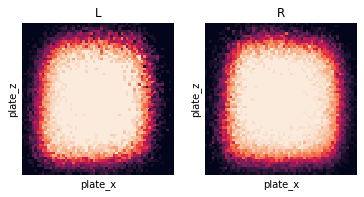

In [144]:
num_bins = 60

fig, ax = plt.subplots(1,2)
for i, stand in enumerate(['L', 'R']):
    ppits = pits.query('stand == @stand')
    bins_x  = pd.cut(ppits['plate_x'], bins=num_bins)
    bins_z  = pd.cut(ppits['plate_z'], bins=num_bins)
    hmap  = ppits.groupby([bins_z, bins_x])['strike'].mean().unstack().sort_index(level=0, ascending=False)
    sns.heatmap(hmap, ax=ax[i], square=True, xticklabels=False, yticklabels=False, cbar=False)
    ax[i].set_title(stand)
fig.show()



<AxesSubplot:xlabel='plate_x', ylabel='plate_z'>

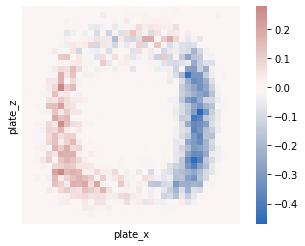

In [161]:
num_bins = 36

def get_heatmap(stand):
    ppits = pits.query('stand == @stand')
    bins_x  = pd.cut(ppits['plate_x'], bins=num_bins)
    bins_z  = pd.cut(ppits['plate_z'], bins=num_bins)
    hmap  = ppits.groupby([bins_z, bins_x])['strike'].mean().unstack().sort_index(level=0, ascending=False)
    return hmap

hmaps = {stand: get_heatmap(stand) for stand in ['L', 'R']}

zone_diff = hmaps['L'] - hmaps['R']
sns.heatmap(zone_diff, center=0, cmap="vlag", square=True, xticklabels=False, yticklabels=False)



In [187]:
fig = px.imshow(zone_diff.reset_index(drop=True).T.reset_index(drop=True).T, color_continuous_scale='RdBu', color_continuous_midpoint=0,
    x=list(range(-18, 18)),
#    y=list(range(48, 12, -1)),
    labels = {'x': 'plate_x', 'y': 'plate_z', 'color': 'diff'}
    )

#fig.update_yaxes(autorange="reversed") # why isn't this working in the right direction?

fig.add_shape(type="rect",
    x0=-8.5, y0=30, x1=8.5, y1=10,
    line=dict(color="Black",width=3)
)


fig.show()

In [ ]:
hmap.reset_index(drop=True).T.reset_index(drop=True)

,0,1,2,3,4,5,6,7,8,9,...,50,51,52,53,54,55,56,57,58,59
0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
2,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.500000,0.142857,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.166667,0.000000,0.333333,0.000000,0.000000,0.000000,0.000000,0.000000
6,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.142857,0.200000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
7,0.000000,0.000000,0.000000,0.000000,0.166667,0.000000,0.142857,0.000000,0.000000,0.000000,...,0.000000,0.333333,0.000000,0.000000,0.000000,0.000000,0.111111,0.285714,0.250000,0.000000
8,0.000000,0.000000,0.200000,0.000000,0.000000,0.166667,0.000000,0.111111,0.000000,0.500000,...,0.500000,0.800000,0.333333,0.750000,0.166667,0.000000,0.000000,0.200000,0.000000,0.090909
9,0.000000,0.000000,0.250000,0.000000,0.000000,0.000000,0.100000,0.000000,0.111111,0.571429,...,0.500000,0.333333,0.333333,0.333333,0.166667,0.166667,0.142857,0.000000,0.000000,0.125000


In [ ]:
px.imshow(hmap.reset_index(drop=True).T.reset_index(drop=True).T)